In [1]:
import pandas as pd
from tabulate import tabulate

df_check = pd.read_csv('prices_round_3_day_0.csv', delimiter=';')

print(tabulate(df_check, headers='keys'))

          day    timestamp  product                        bid_price_1    bid_volume_1    bid_price_2    bid_volume_2    bid_price_3    bid_volume_3    ask_price_1    ask_volume_1    ask_price_2    ask_volume_2    ask_price_3    ask_volume_3    mid_price    profit_and_loss
------  -----  -----------  ---------------------------  -------------  --------------  -------------  --------------  -------------  --------------  -------------  --------------  -------------  --------------  -------------  --------------  -----------  -----------------
     0      0            0  VOLCANIC_ROCK_VOUCHER_10500             99              19            nan             nan            nan             nan            100              19            nan             nan            nan             nan         99.5                  0
     1      0            0  DJEMBES                              13493              72            nan             nan            nan             nan          13494              7

In [2]:
import matplotlib.pyplot as plt

df = {}
products =['VOLCANIC_ROCK', 'VOLCANIC_ROCK_VOUCHER_9500','VOLCANIC_ROCK_VOUCHER_9750','VOLCANIC_ROCK_VOUCHER_10000','VOLCANIC_ROCK_VOUCHER_10250','VOLCANIC_ROCK_VOUCHER_10500']

for prod in products:
    df[prod] = df_check[df_check['product'] == prod]

df_rock = df['VOLCANIC_ROCK']
df_v95 = df['VOLCANIC_ROCK_VOUCHER_9500']
df_v97 = df['VOLCANIC_ROCK_VOUCHER_9750']
df_v100 = df['VOLCANIC_ROCK_VOUCHER_10000']
df_v102 = df['VOLCANIC_ROCK_VOUCHER_10250']
df_v105 = df['VOLCANIC_ROCK_VOUCHER_10500']


In [3]:
# Compute all the weighted mid prices

import numpy as np
import math

bid_price_1 = {}
bid_volume_1 = {}
bid_price_2 = {}
bid_volume_2 = {}
bid_price_3 = {}
bid_volume_3 = {}
ask_price_1 = {}
ask_volume_1 = {}
ask_price_2 = {}
ask_volume_2 = {}
ask_price_3 = {}
ask_volume_3 = {}

products =['VOLCANIC_ROCK', 'VOLCANIC_ROCK_VOUCHER_9500','VOLCANIC_ROCK_VOUCHER_9750','VOLCANIC_ROCK_VOUCHER_10000','VOLCANIC_ROCK_VOUCHER_10250','VOLCANIC_ROCK_VOUCHER_10500']

for prod in products:
    bid_price_1[prod] = list(df[prod]['bid_price_1'])
    bid_volume_1[prod] = list(df[prod]['bid_volume_1'])
    bid_price_2[prod] = list(df[prod]['bid_price_2'])
    bid_volume_2[prod] = list(df[prod]['bid_volume_2'])
    bid_price_3[prod] = list(df[prod]['bid_price_3'])
    bid_volume_3[prod] = list(df[prod]['bid_volume_3'])

    ask_price_1[prod] = list(df[prod]['ask_price_1'])
    ask_volume_1[prod] = list(df[prod]['ask_volume_1'])
    ask_price_2[prod] = list(df[prod]['ask_price_2'])
    ask_volume_2[prod] = list(df[prod]['ask_volume_2'])
    ask_price_3[prod] = list(df[prod]['ask_price_3'])
    ask_volume_3[prod] = list(df[prod]['ask_volume_3'])

mid_weight = {}

for prod in products:
    mid_weight[prod] = []

    for i in range(len(bid_price_1[prod])):
        total_weight = 0
        mid_weight_curr = 0
        if not math.isnan(bid_price_1[prod][i]):
            mid_weight_curr += bid_price_1[prod][i] * bid_volume_1[prod][i]
            total_weight += bid_volume_1[prod][i]
    
        if not math.isnan(bid_price_2[prod][i]):
            mid_weight_curr += bid_price_2[prod][i] * bid_volume_2[prod][i]
            total_weight += bid_volume_2[prod][i]
    
        if not math.isnan(bid_price_3[prod][i]):
            mid_weight_curr += bid_price_3[prod][i] * bid_volume_3[prod][i]
            total_weight += bid_volume_3[prod][i]

        if not math.isnan(ask_price_1[prod][i]):
            mid_weight_curr += ask_price_1[prod][i] * ask_volume_1[prod][i]
            total_weight += ask_volume_1[prod][i]
    
        if not math.isnan(ask_price_2[prod][i]):
            mid_weight_curr += ask_price_2[prod][i] * ask_volume_2[prod][i]
            total_weight += ask_volume_2[prod][i]
    
        if not math.isnan(ask_price_3[prod][i]):
            mid_weight_curr += ask_price_3[prod][i] * ask_volume_3[prod][i]
            total_weight += ask_volume_3[prod][i]

        mid_weight[prod].append(mid_weight_curr / total_weight if total_weight != 0 else 0)
    


C:\Users\amino\AppData\Local\Temp\ipykernel_18476\4268353500.py:13: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


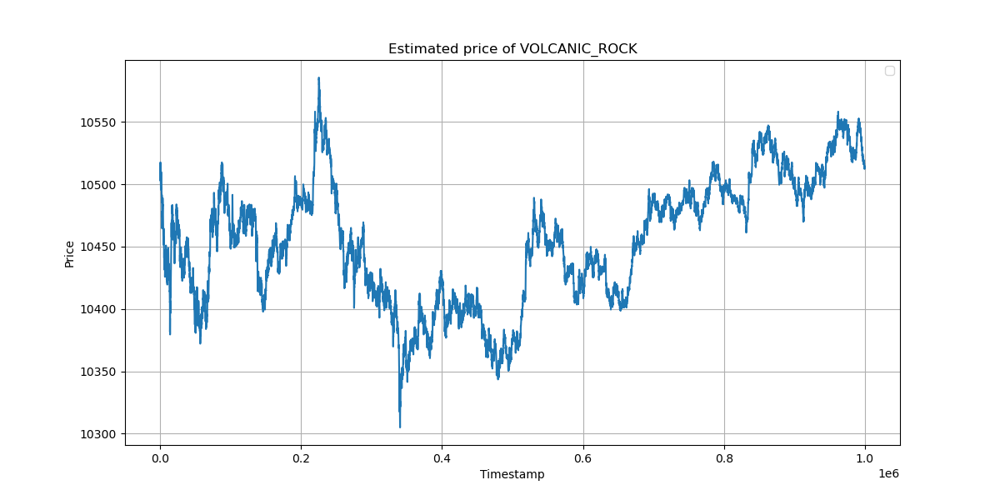

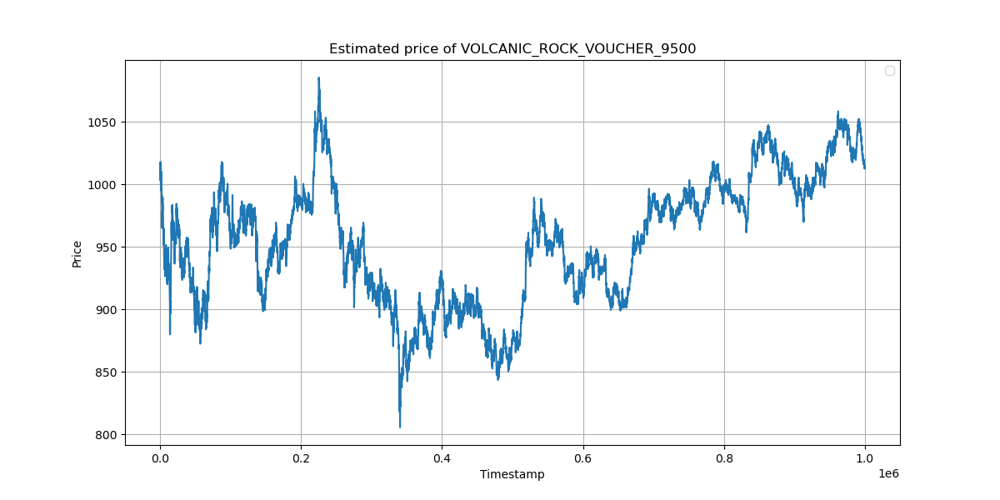

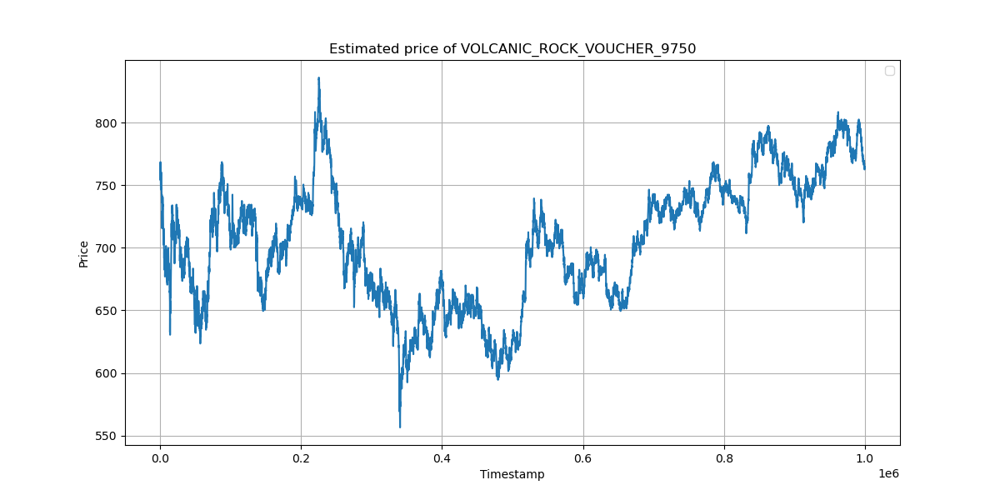

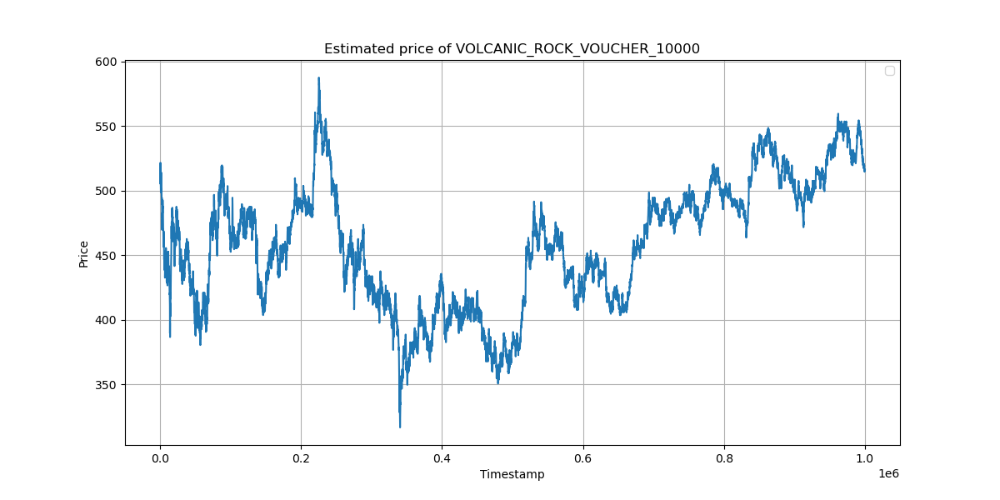

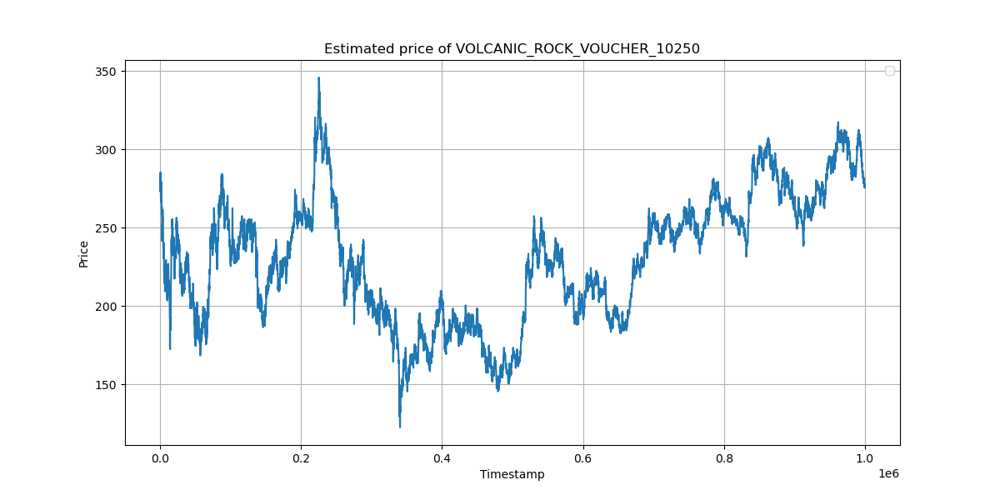

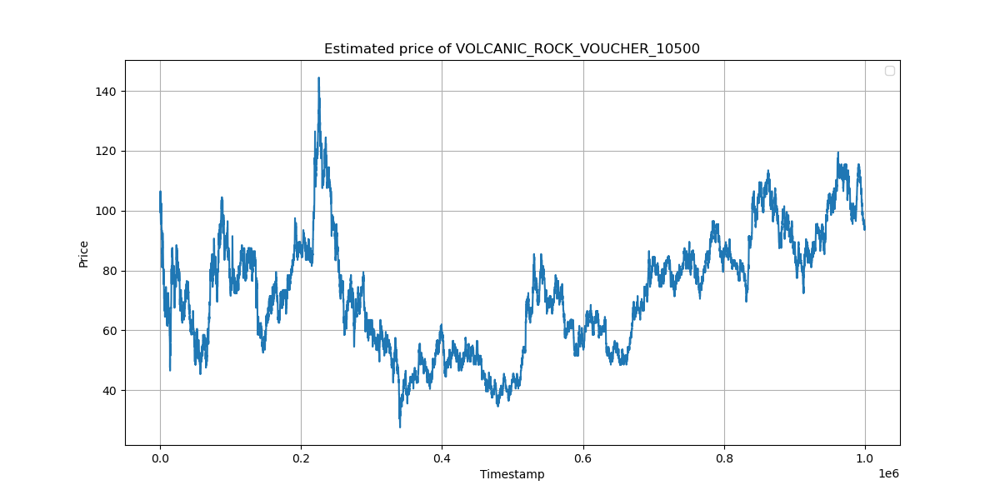

In [4]:
%matplotlib ipympl
import matplotlib.pyplot as plt

time = list(df_rock['timestamp'])


for prod in products:
    plt.figure(figsize=(12, 6))
    plt.plot(time, mid_weight[prod])
    plt.xlabel('Timestamp')
    plt.ylabel('Price')
    plt.title('Estimated price of ' + prod)
    plt.legend()
    plt.grid(True)
    #plt.xlim([800000,1000000])
    plt.show()

In [ ]:
%matplotlib ipympl
import numpy as np
import math
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

time_lst = list(df_rock['timestamp'])

products =['VOLCANIC_ROCK', 'VOLCANIC_ROCK_VOUCHER_9500','VOLCANIC_ROCK_VOUCHER_9750','VOLCANIC_ROCK_VOUCHER_10000','VOLCANIC_ROCK_VOUCHER_10250','VOLCANIC_ROCK_VOUCHER_10500']
rock_mprice = mid_weight['VOLCANIC_ROCK']

intercepts = {}
coeffs = {}

for prod in products[1:]:
    # Linear Regression model
    model = LinearRegression()

    Vars = []
    y = []
    time = []

    for i in range(len(rock_mprice)):
        Vars.append([mid_weight[prod][i]])
        y.append(rock_mprice[i])
        time.append(time_lst[i])

    X = np.array(Vars)

    # Fitting the model
    model.fit(X, y)

    # Prediction
    y_pred = model.predict(X)

    intercepts[prod] = model.intercept_
    coeffs[prod] = model.coef_[0]

    # Coefficients and intercept
    print(prod + " Intercept:", intercepts[prod])
    print(prod + " Coefficient:", coeffs[prod])

    

    #print(prod + " root of MSE: ",math.sqrt(mean_squared_error(y, y_pred)))

VOLCANIC_ROCK_VOUCHER_9500 Intercept: 9498.666492187782
VOLCANIC_ROCK_VOUCHER_9500 Coefficient: 1.0010525374761166
VOLCANIC_ROCK_VOUCHER_9750 Intercept: 9745.797500079372
VOLCANIC_ROCK_VOUCHER_9750 Coefficient: 1.004849068771394
VOLCANIC_ROCK_VOUCHER_10000 Intercept: 9980.868095273509
VOLCANIC_ROCK_VOUCHER_10000 Coefficient: 1.0331184274573622
VOLCANIC_ROCK_VOUCHER_10250 Intercept: 10168.323275987561
VOLCANIC_ROCK_VOUCHER_10250 Coefficient: 1.2429590528399903
VOLCANIC_ROCK_VOUCHER_10500 Intercept: 10272.272262726901
VOLCANIC_ROCK_VOUCHER_10500 Coefficient: 2.5040947627338603


In [6]:
%matplotlib ipympl
import numpy as np
import math
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

time_lst = list(df_rock['timestamp'])

products =['VOLCANIC_ROCK', 'VOLCANIC_ROCK_VOUCHER_9500','VOLCANIC_ROCK_VOUCHER_9750','VOLCANIC_ROCK_VOUCHER_10000','VOLCANIC_ROCK_VOUCHER_10250','VOLCANIC_ROCK_VOUCHER_10500']
rock_mprice = mid_weight['VOLCANIC_ROCK']

intercepts = {}
coeffs = {}

for prod in products[1:]:
    # Linear Regression model
    model = LinearRegression()

    Vars = []
    y = []
    time = []

    for i in range(len(rock_mprice)):
        Vars.append([rock_mprice[i]])
        y.append(mid_weight[prod][i])
        time.append(time_lst[i])

    X = np.array(Vars)

    # Fitting the model
    model.fit(X, y)

    # Prediction
    y_pred = model.predict(X)

    intercepts[prod] = model.intercept_
    coeffs[prod] = model.coef_[0]

    # Coefficients and intercept
    #print(prod + " Intercept:", intercepts[prod])
    print(prod + " Coefficient:", coeffs[prod])

    

    #print(prod + " root of MSE: ",math.sqrt(mean_squared_error(y, y_pred)))

VOLCANIC_ROCK_VOUCHER_9500 Coefficient: 0.9989168760199643
VOLCANIC_ROCK_VOUCHER_9750 Coefficient: 0.9951266261151751
VOLCANIC_ROCK_VOUCHER_10000 Coefficient: 0.9676415792197337
VOLCANIC_ROCK_VOUCHER_10250 Coefficient: 0.8023488859204622
VOLCANIC_ROCK_VOUCHER_10500 Coefficient: 0.3888565769627859


In [47]:
from statistics import NormalDist

K = {"VOLCANIC_ROCK_VOUCHER_9500": 9500,"VOLCANIC_ROCK_VOUCHER_9750": 9750,"VOLCANIC_ROCK_VOUCHER_10250": 10250,"VOLCANIC_ROCK_VOUCHER_10000": 10000,"VOLCANIC_ROCK_VOUCHER_10500": 10500}
current_day = 0

stock_price = rock_mprice
call_prices = {}
low_vol = 10**(-7)
high_vol = 10**(-2)
max_iterations=100
tolerance=1e-8
normal_dist = NormalDist(mu=0, sigma=1)
T = 7 * 10000
iv_dct = {}
time_exp = [7 * (10 ** 4)  - 10000 * current_day - (x/100) for x in time_lst]

for prod in products[1:]:
    call_prices[prod] = mid_weight[prod]

for prod in products[1:]:
        iv_dct[prod] = []
        for i in range(len(stock_price)):
            iv = (low_vol + high_vol) / 2.0  # Initial guess as the midpoint

            for _ in range(max_iterations):
                
                d1 = np.log(stock_price[i]/K[prod])/(np.sqrt(time_exp[i]) * iv) + iv * np.sqrt(time_exp[i])/2
                d2 = d1 - iv * np.sqrt(time_exp[i])
                estimated_price = stock_price[i] * normal_dist.cdf(d1) - K[prod] * normal_dist.cdf(d2)
                diff = estimated_price - call_prices[prod][i]
                if abs(diff) < tolerance:
                    break
                elif diff > 0:
                    high_vol = iv
                else:
                    low_vol = iv
                iv = (low_vol + high_vol) / 2.0

            iv_dct[prod].append(iv)



C:\Users\amino\AppData\Local\Temp\ipykernel_18476\3957459162.py:7: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


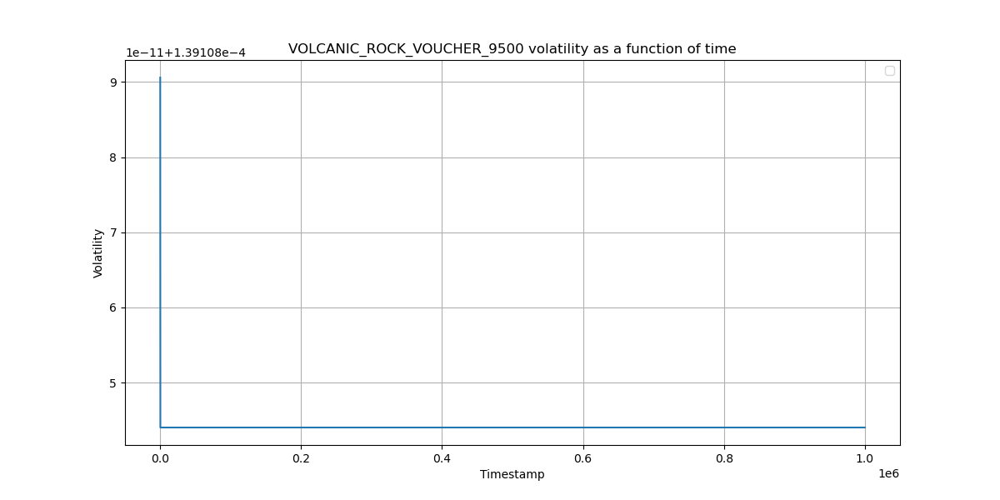

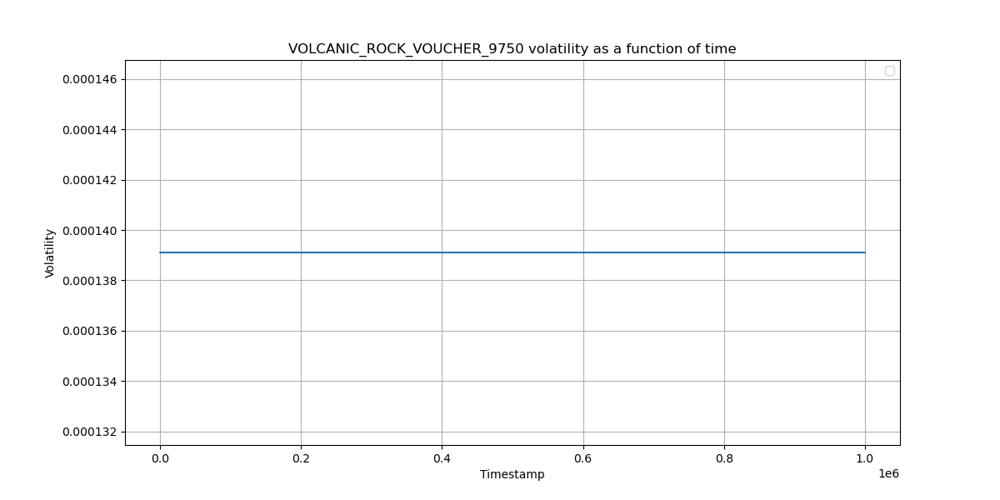

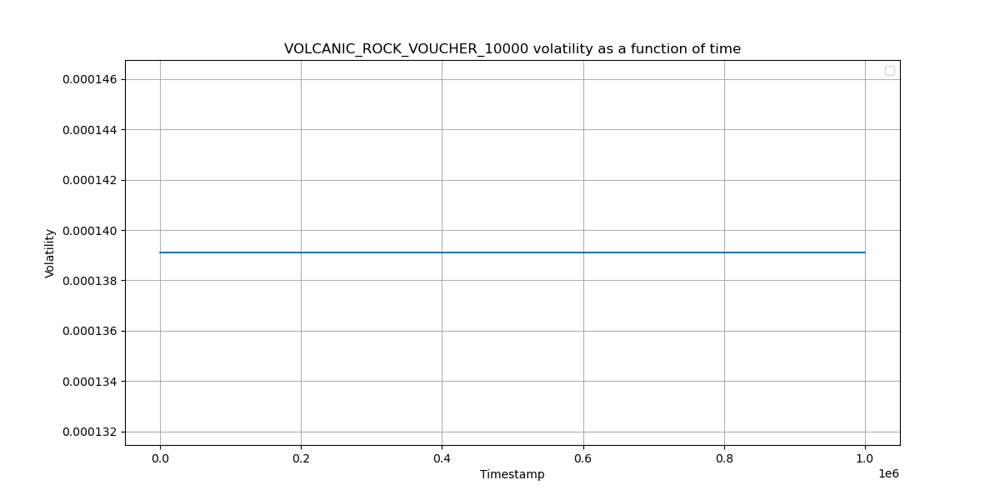

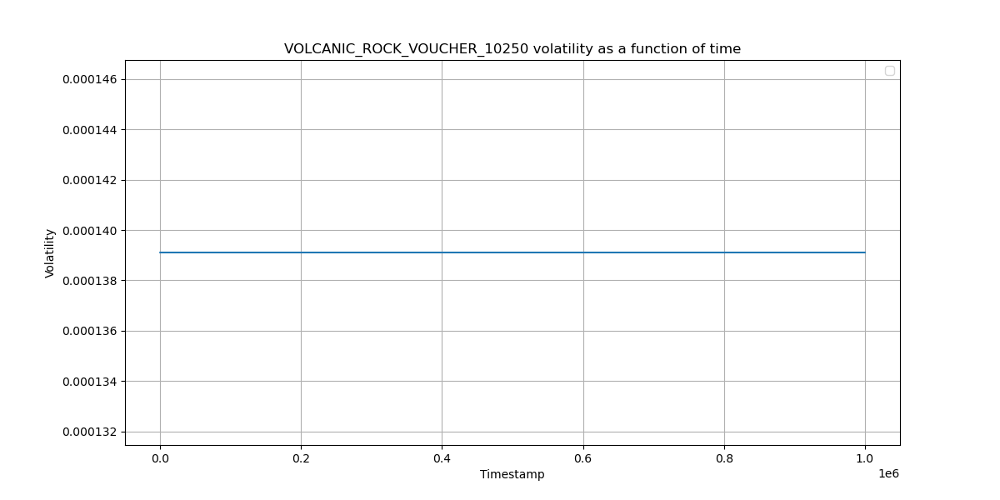

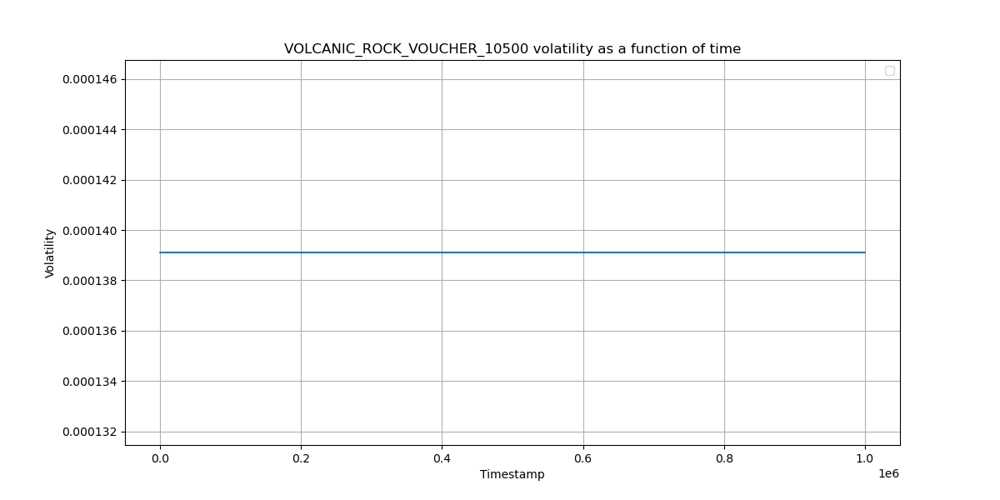

In [46]:
for prod in products[1:]:
    plt.figure(figsize=(12, 6))
    plt.plot(time_lst,iv_dct[prod])
    plt.xlabel('Timestamp')
    plt.ylabel('Volatility')
    plt.title(prod + ' volatility as a function of time')
    plt.legend()
    plt.grid(True)
    plt.show()

In [17]:
from scipy.optimize import brentq
from scipy.stats import norm
import numpy as np

#Vouchers
products =['VOLCANIC_ROCK', 'VOLCANIC_ROCK_VOUCHER_9500','VOLCANIC_ROCK_VOUCHER_9750','VOLCANIC_ROCK_VOUCHER_10000','VOLCANIC_ROCK_VOUCHER_10250','VOLCANIC_ROCK_VOUCHER_10500']
K = {}
K['VOLCANIC_ROCK_VOUCHER_9500'] = 9500
K['VOLCANIC_ROCK_VOUCHER_9750'] = 9750
K['VOLCANIC_ROCK_VOUCHER_10000'] = 10000
K['VOLCANIC_ROCK_VOUCHER_10250'] = 10250
K['VOLCANIC_ROCK_VOUCHER_10500'] = 10500

S_lst = mid_weight['VOLCANIC_ROCK']
tau_lst = [7 * (10 ** 4) - (x/100) for x in time_lst]
sigma_lst = {}

def bs_call_price(S, K, T, r, sigma):
    d1 = (np.log(S/K) + (r + (sigma**2) / 2)*T) / (sigma*np.sqrt(T))
    d2 = d1 - sigma*np.sqrt(T)
    return S * norm.cdf(d1) - K * np.exp(-r*T) * norm.cdf(d2)

def implied_vol(C_market, S, K, T, r):
    func = lambda sigma: bs_call_price(S, K, T, r, sigma) - C_market
    return brentq(func, -1, 1,xtol=1e-8, rtol=1e-8, maxiter=400)

num_lst = {}
m_t = {}
delta = {}

for prod in products[1:]:
   sigma_lst[prod] = []
   m_t[prod] = []
   delta[prod] = []
   for i in range(len(S_lst)):
    iv = implied_vol(mid_weight[prod][i], S_lst[i], K[prod], tau_lst[i], 0)
    if iv > 0.000075:
        sigma_lst[prod].append(iv)
        m_t[prod].append(- np.log(S_lst[i]/K[prod])/np.sqrt(tau_lst[i]))
        d1 = np.log(S_lst[i]/K[prod])/(np.sqrt(tau_lst[i]) * iv) + iv * np.sqrt(tau_lst[i])/2
        delta[prod].append(norm.cdf(d1))



C:\Users\amino\AppData\Local\Temp\ipykernel_18476\1162364753.py:7: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


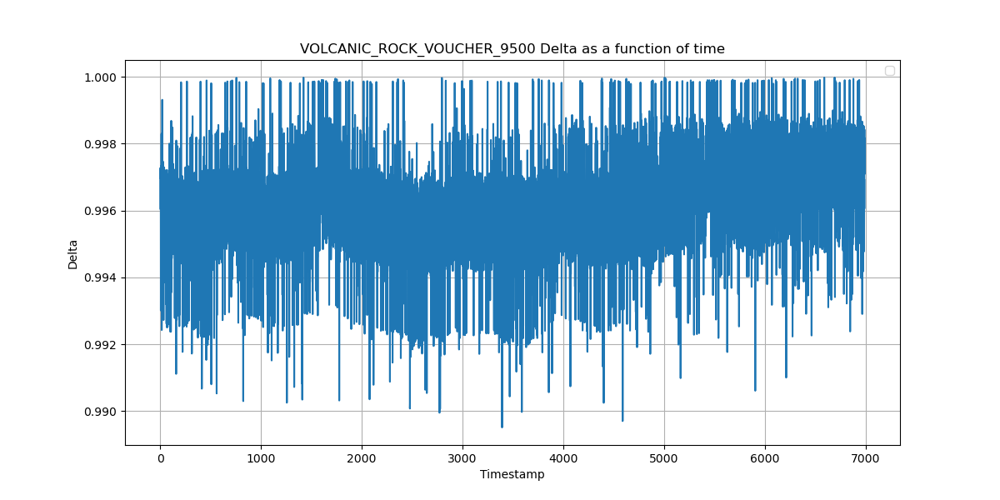

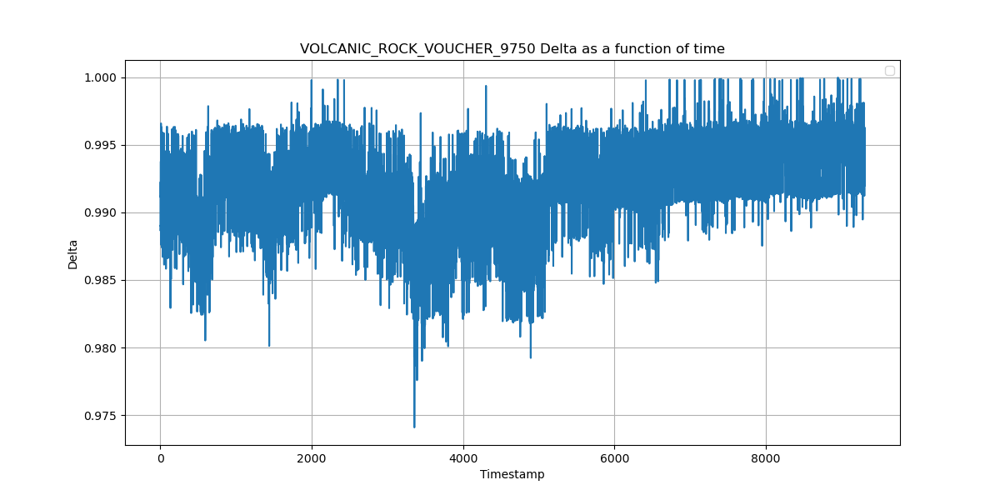

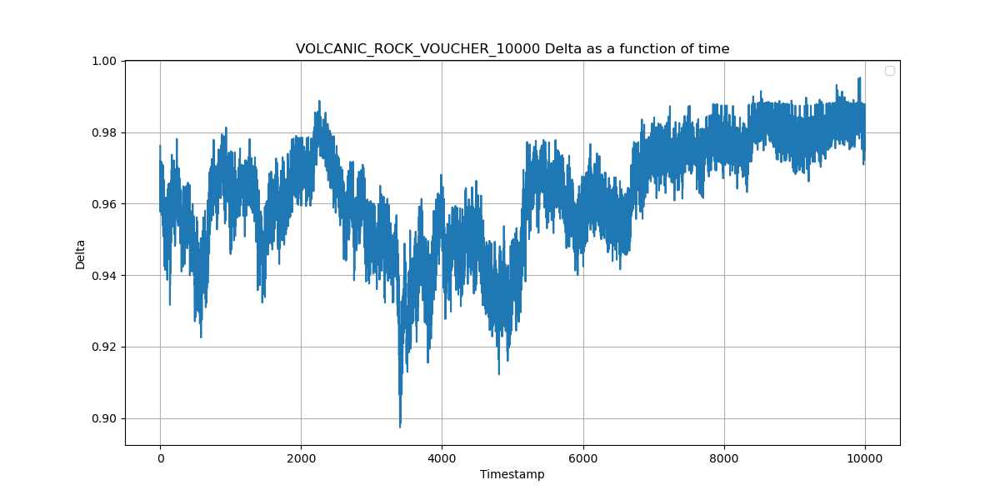

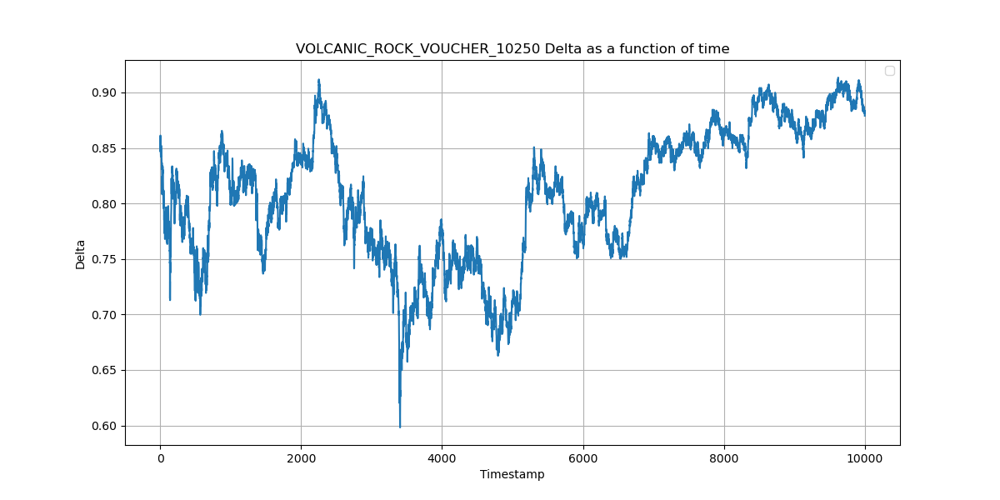

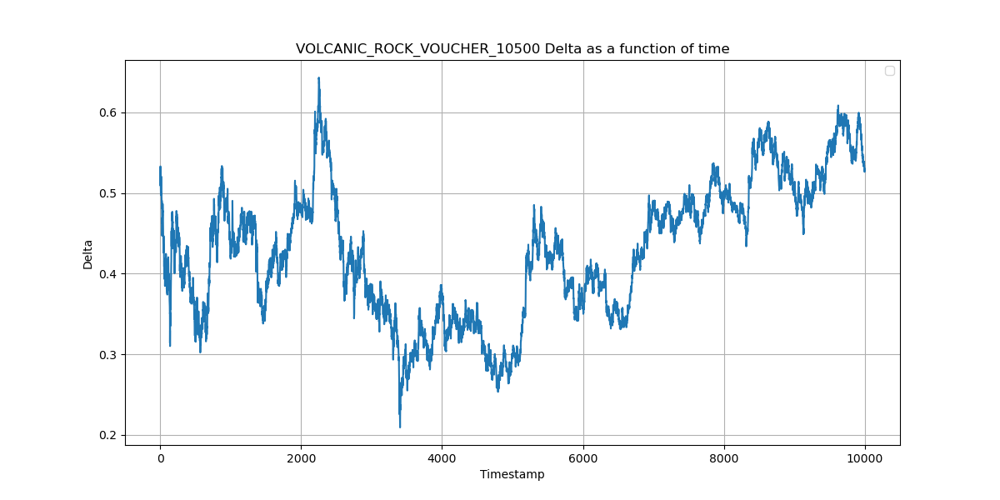

In [22]:
for prod in products[1:]:
    plt.figure(figsize=(12, 6))
    plt.plot([i for i in range(len(sigma_lst[prod]))],delta[prod])
    plt.xlabel('Timestamp')
    plt.ylabel('Delta')
    plt.title(prod + ' Delta as a function of time')
    plt.legend()
    plt.grid(True)
    plt.show()

In [9]:
import numpy as np
from scipy.optimize import curve_fit
import matplotlib.pyplot as plt


# Define the parabolic function
def parabola(x, a, b, c):
    return a * x**2 + b * x + c


fit_param = []
y_fit = []

for k in range(len(sigma_lst[products[1]])):
    Vars = []
    y = []
    
    for i in range(1,6):
        Vars.append(m_t[products[i]][k])
        y.append(sigma_lst[products[i]][k])

    X = np.array(Vars)

    # Fit the data to the parabolic function
    popt, pcov = curve_fit(parabola, X, y)

    # Extract the fitted parameters
    a_fit, b_fit, c_fit = popt

    fit_param.append([a_fit, b_fit, c_fit])

    # Generate y values for the fitted curve
    y_fit.append(parabola(X, a_fit, b_fit, c_fit))


In [10]:
y_fit[k]

array([1.40951348e-04, 1.10721409e-04, 9.52252388e-05, 8.65595515e-05,
       8.49078262e-05])

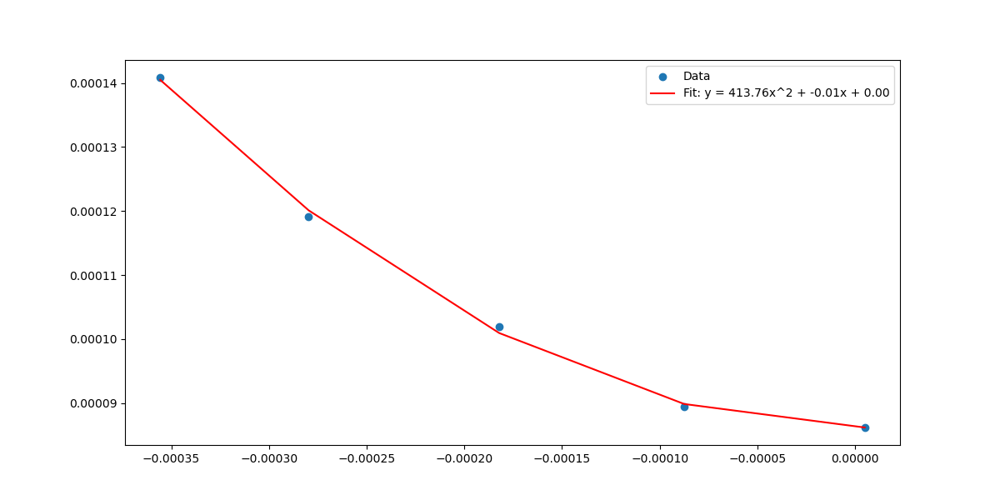

In [11]:
k = 2000

import matplotlib.pyplot as plt
import numpy as np
from matplotlib.widgets import Slider

Vars = []
y = []

for i in range(1,6):
    Vars.append(m_t[products[i]][k])
    y.append(sigma_lst[products[i]][k])

X = np.array(Vars)

# Plot the original data and the fitted curve
plt.figure(figsize=(12, 6))
plt.scatter(X, y, label='Data')
plt.plot(X, y_fit[k], label=f'Fit: y = {fit_param[k][0]:.2f}x^2 + {fit_param[k][1]:.2f}x + {fit_param[k][2]:.2f}', color='red')
plt.legend()

plt.show()

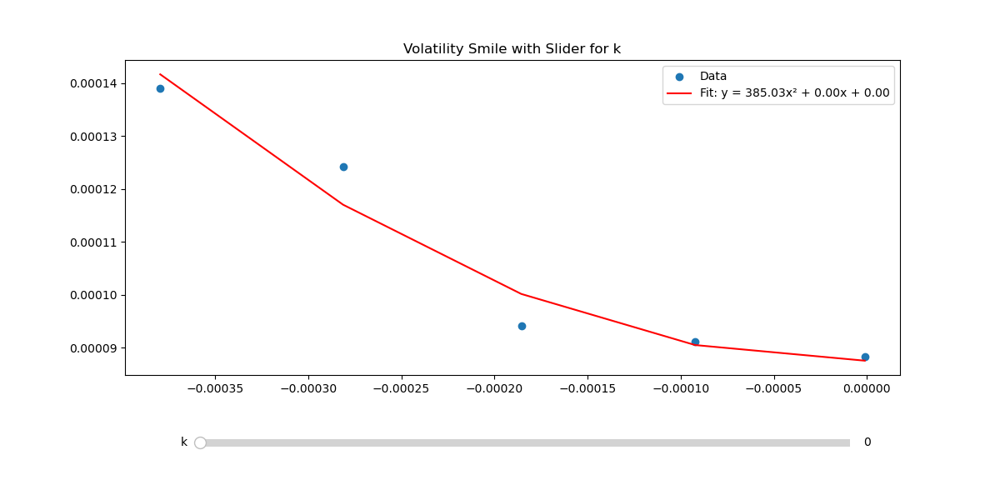

In [12]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.widgets import Slider

# Initial setup
products =['VOLCANIC_ROCK', 'VOLCANIC_ROCK_VOUCHER_9500','VOLCANIC_ROCK_VOUCHER_9750','VOLCANIC_ROCK_VOUCHER_10000','VOLCANIC_ROCK_VOUCHER_10250','VOLCANIC_ROCK_VOUCHER_10500']
k_init = 0  # initial k

# Create figure and axis
fig, ax = plt.subplots(figsize=(12, 6))
plt.subplots_adjust(bottom=0.25)

# Dummy init data for first draw
Vars = [m_t[products[i]][k_init] for i in range(1, 6)]
y_vals = [sigma_lst[products[i]][k_init] for i in range(1, 6)]
X = np.array(Vars)
sc = ax.scatter(X, y_vals, label='Data')
fit_line, = ax.plot(X, y_fit[k_init], color='red',
                    label=f'Fit: y = {fit_param[k_init][0]:.2f}x² + {fit_param[k_init][1]:.2f}x + {fit_param[k_init][2]:.2f}')

ax.legend()
ax.set_title('Volatility Smile with Slider for k')

# Slider for k (index in your time series)
ax_slider = plt.axes([0.2, 0.1, 0.65, 0.03])
slider_k = Slider(ax_slider, 'k', valmin=0, valmax=len(m_t[products[1]]) - 1, valinit=k_init, valstep=1)

# Update function
def update(val):
    k = int(slider_k.val)
    Vars = [m_t[products[i]][k] for i in range(1, 6)]
    y_vals = [sigma_lst[products[i]][k] for i in range(1, 6)]
    X = np.array(Vars)

    sc.set_offsets(np.c_[X, y_vals])
    fit_line.set_xdata(X)
    fit_line.set_ydata(y_fit[k])
    fit_line.set_label(f'Fit: y = {fit_param[k][0]:.2f}x² + {fit_param[k][1]:.2f}x + {fit_param[k][2]:.2f}')
    
    ax.set_ylim(0, 0.00018)
    ax.set_xlim(- 0.00045, 0.0001)
    ax.legend()
    fig.canvas.draw_idle()

slider_k.on_changed(update)

plt.show()

C:\Users\amino\AppData\Local\Temp\ipykernel_29284\898041307.py:6: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


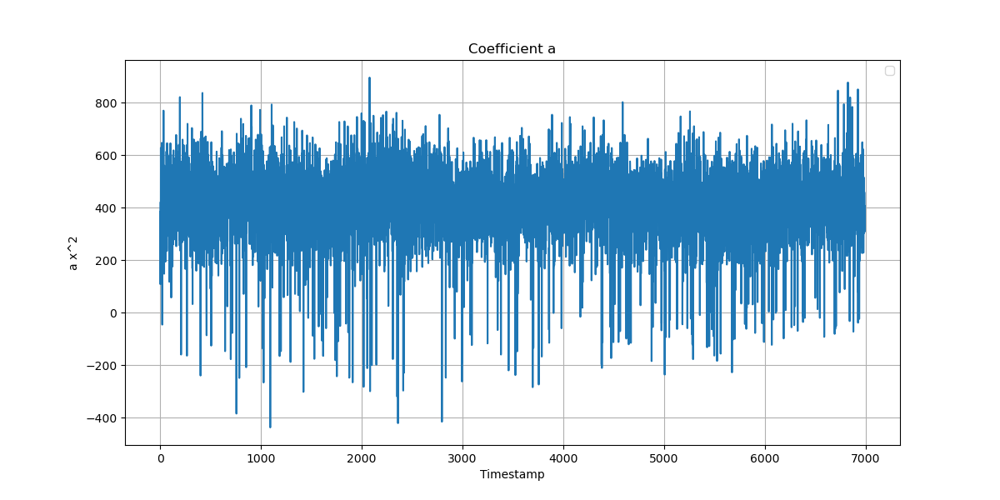

C:\Users\amino\AppData\Local\Temp\ipykernel_29284\898041307.py:15: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


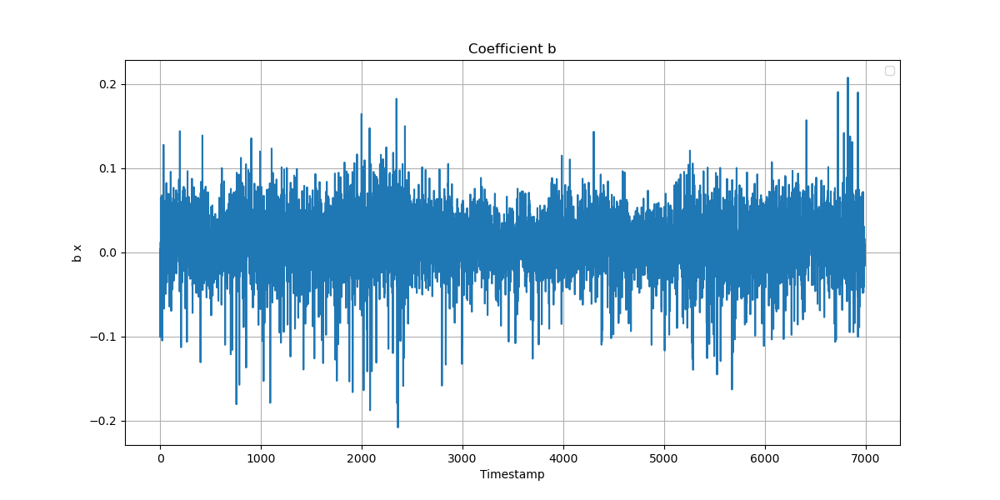

C:\Users\amino\AppData\Local\Temp\ipykernel_29284\898041307.py:24: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


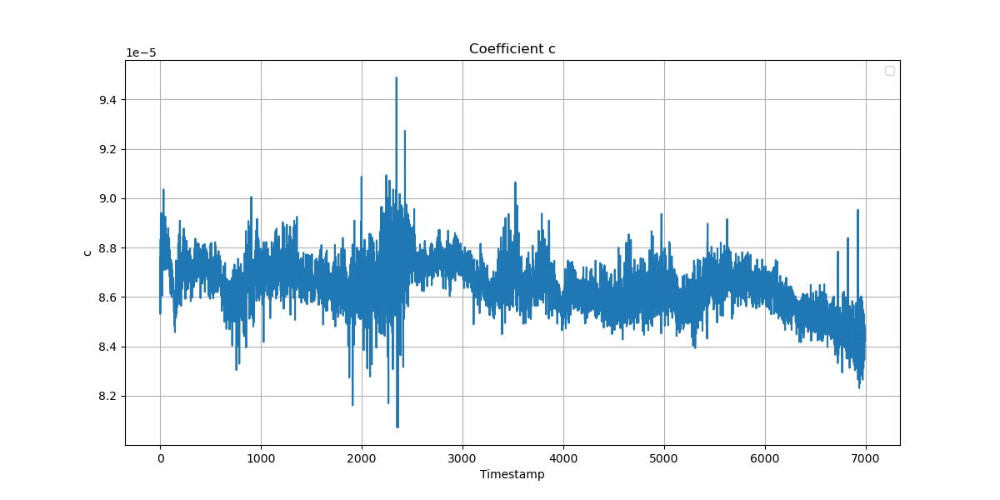

In [123]:
plt.figure(figsize=(12, 6))
plt.plot([i for i in range(len(sigma_lst[products[1]]))],[fit_param[i][0] for i in range(len(sigma_lst[products[1]]))])
plt.xlabel('Timestamp')
plt.ylabel('a x^2')
plt.title('Coefficient a')
plt.legend()
plt.grid(True)
plt.show()

plt.figure(figsize=(12, 6))
plt.plot([i for i in range(len(sigma_lst[products[1]]))],[fit_param[i][1] for i in range(len(sigma_lst[products[1]]))])
plt.xlabel('Timestamp')
plt.ylabel('b x')
plt.title('Coefficient b')
plt.legend()
plt.grid(True)
plt.show()

plt.figure(figsize=(12, 6))
plt.plot([i for i in range(len(sigma_lst[products[1]]))],[fit_param[i][2] for i in range(len(sigma_lst[products[1]]))])
plt.xlabel('Timestamp')
plt.ylabel('c')
plt.title('Coefficient c')
plt.legend()
plt.grid(True)
plt.show()

C:\Users\amino\AppData\Local\Temp\ipykernel_18476\3766975354.py:10: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


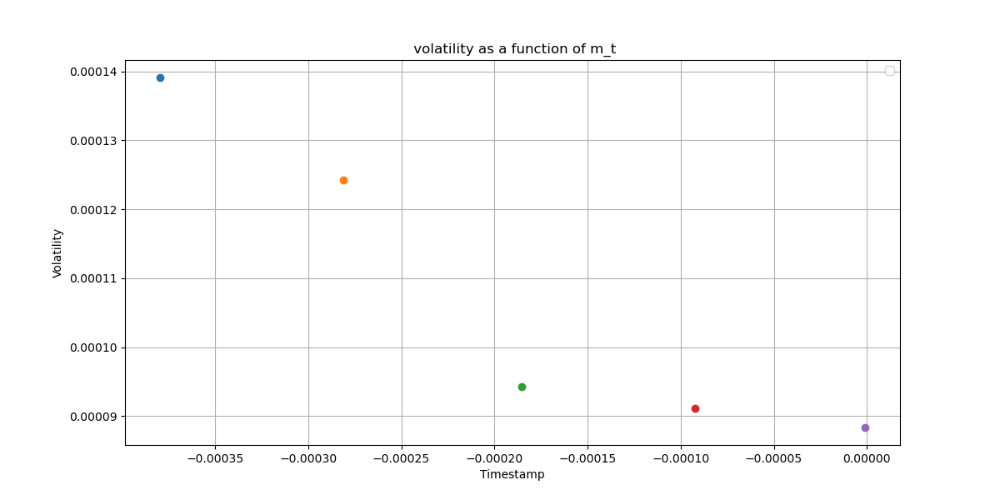

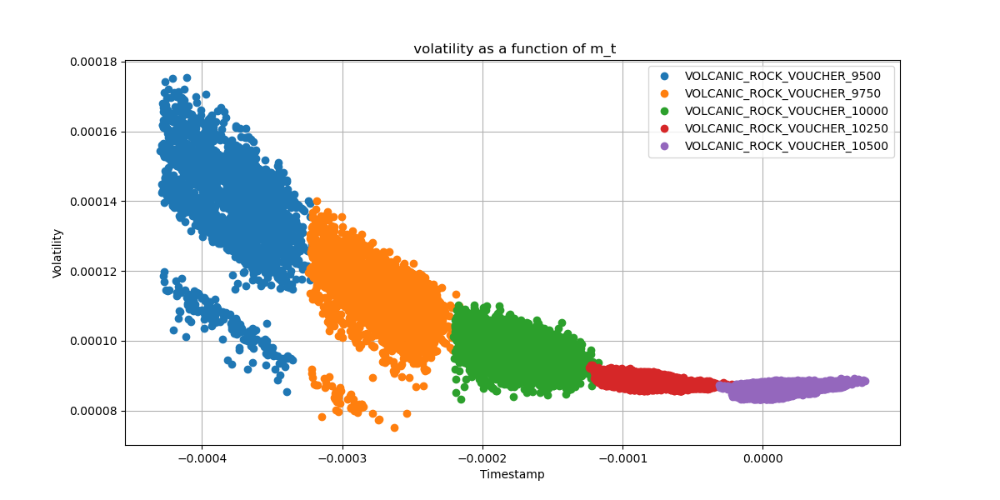

In [15]:
plt.figure(figsize=(12, 6))
plt.plot(m_t[products[1]][0],sigma_lst[products[1]][0],'o')
plt.plot(m_t[products[2]][0],sigma_lst[products[2]][0],'o')
plt.plot(m_t[products[3]][0],sigma_lst[products[3]][0],'o')
plt.plot(m_t[products[4]][0],sigma_lst[products[4]][0],'o')
plt.plot(m_t[products[5]][0],sigma_lst[products[5]][0],'o')
plt.xlabel('Timestamp')
plt.ylabel('Volatility')
plt.title(' volatility as a function of m_t')
plt.legend()
plt.grid(True)
plt.show()

plt.figure(figsize=(12, 6))
plt.plot(m_t[products[1]],sigma_lst[products[1]],'o',label = f"{products[1]}")
plt.plot(m_t[products[2]],sigma_lst[products[2]],'o',label = f"{products[2]}")
plt.plot(m_t[products[3]],sigma_lst[products[3]],'o',label = f"{products[3]}")
plt.plot(m_t[products[4]],sigma_lst[products[4]],'o',label = f"{products[4]}")
plt.plot(m_t[products[5]],sigma_lst[products[5]],'o',label = f"{products[5]}")
plt.xlabel('Timestamp')
plt.ylabel('Volatility')
plt.title(' volatility as a function of m_t')
plt.legend()
plt.grid(True)
plt.show()

In [66]:
# for prod in products[1:]:
#     plt.figure(figsize=(12, 6))
#     plt.plot(df_rock['timestamp'],sigma_lst[prod],'o')
#     plt.xlabel('Timestamp')
#     plt.ylabel('Volatility')
#     plt.title(prod + ' volatility as a function of time')
#     plt.legend()
#     plt.grid(True)
#     plt.show()

In [80]:
from scipy.stats import norm
import scipy.stats as st
import math

#Vouchers delta
products =['VOLCANIC_ROCK', 'VOLCANIC_ROCK_VOUCHER_9500','VOLCANIC_ROCK_VOUCHER_9750','VOLCANIC_ROCK_VOUCHER_10000','VOLCANIC_ROCK_VOUCHER_10250','VOLCANIC_ROCK_VOUCHER_10500']
K = {}
K['VOLCANIC_ROCK_VOUCHER_9500'] = 9500
K['VOLCANIC_ROCK_VOUCHER_9750'] = 9750
K['VOLCANIC_ROCK_VOUCHER_10000'] = 10000
K['VOLCANIC_ROCK_VOUCHER_10250'] = 10250
K['VOLCANIC_ROCK_VOUCHER_10500'] = 10500

sigma = {}
sigma['VOLCANIC_ROCK_VOUCHER_9500'] = 0.000120
sigma['VOLCANIC_ROCK_VOUCHER_9750'] = 0.000101
sigma['VOLCANIC_ROCK_VOUCHER_10000'] = 0.000091
sigma['VOLCANIC_ROCK_VOUCHER_10250'] = 0.0000858
sigma['VOLCANIC_ROCK_VOUCHER_10500'] = 0.0000684

c_prices = {}
c_prices_delta = {}
delta_lst = {}
delta2_lst = {}

tau_lst = [7 * (10 ** 4) - (x/100) for x in time_lst]
S_lst = mid_weight['VOLCANIC_ROCK']

for prod in products[1:]:
    delta_lst[prod] = []
    delta2_lst[prod] = []

    # Calculate the inverse CDF for a given probability
    mean = 0
    standard_deviation = 1

    for i in range(len(S_lst)):
        d1 = math.log(S_lst[i]/K[prod]) / (sigma[prod] * math.sqrt(tau_lst[i]))
        d1 += sigma[prod] * math.sqrt(tau_lst[i])/2

        d2 = math.log(S_lst[i]/K[prod]) / (sigma[prod] * math.sqrt(tau_lst[i]))
        d2 -= sigma[prod] * math.sqrt(tau_lst[i])/2

        delta_lst[prod].append(st.norm.cdf(d1,loc = mean, scale = standard_deviation))
        delta2_lst[prod].append(st.norm.cdf(d2,loc = mean, scale = standard_deviation))

    # BS price of the voucher

    c_prices[prod] = [S_lst[i] * delta_lst[prod][i] - K[prod] * delta2_lst[prod][i] for i in range(len(S_lst))]
    c_prices_delta[prod] = [S_lst[i] * delta_lst[prod][i] for i in range(len(S_lst))]

    c_intercepts = {}
c_coeffs = {}

for prod in products[1:]:
    # Linear Regression model
    model = LinearRegression()

    Vars = []
    y = []
    time = []

    for i in range(len(rock_mprice)):
        Vars.append([rock_mprice[i]])
        y.append(c_prices[prod][i])
        time.append(time_lst[i])

    X = np.array(Vars)

    # Fitting the model
    model.fit(X, y)

    # Prediction
    y_pred = model.predict(X)

    c_intercepts[prod] = model.intercept_
    c_coeffs[prod] = model.coef_[0]

    # Coefficients and intercept
    #print(prod + " Intercept:", c_intercepts[prod])
    print(prod + " Coefficient:", c_coeffs[prod])

    

    #print(prod + " root of MSE: ",math.sqrt(mean_squared_error(y, y_pred)))



VOLCANIC_ROCK_VOUCHER_9500 Coefficient: 0.9989015230735736
VOLCANIC_ROCK_VOUCHER_9750 Coefficient: 0.9958401012135429
VOLCANIC_ROCK_VOUCHER_10000 Coefficient: 0.96788006279531
VOLCANIC_ROCK_VOUCHER_10250 Coefficient: 0.8022417456003027
VOLCANIC_ROCK_VOUCHER_10500 Coefficient: 0.3889155818725707


C:\Users\amino\AppData\Local\Temp\ipykernel_27212\1426747635.py:13: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


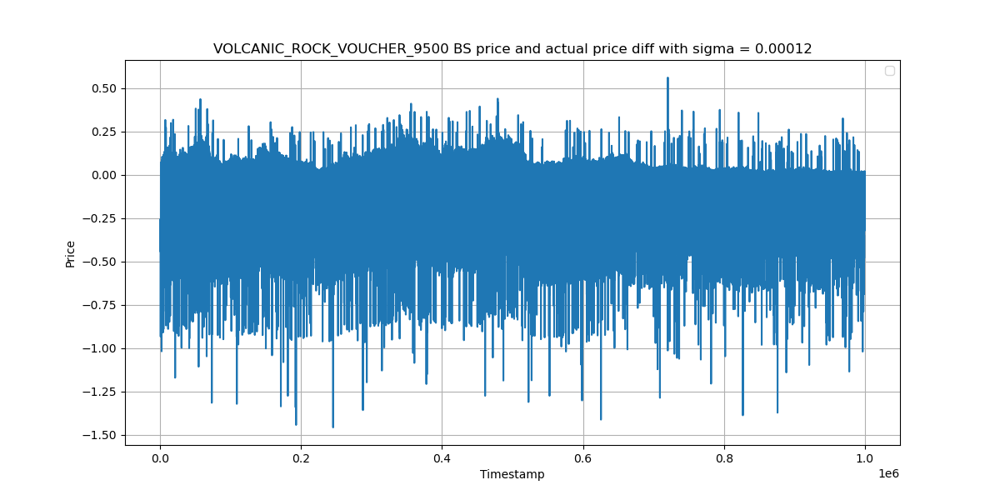

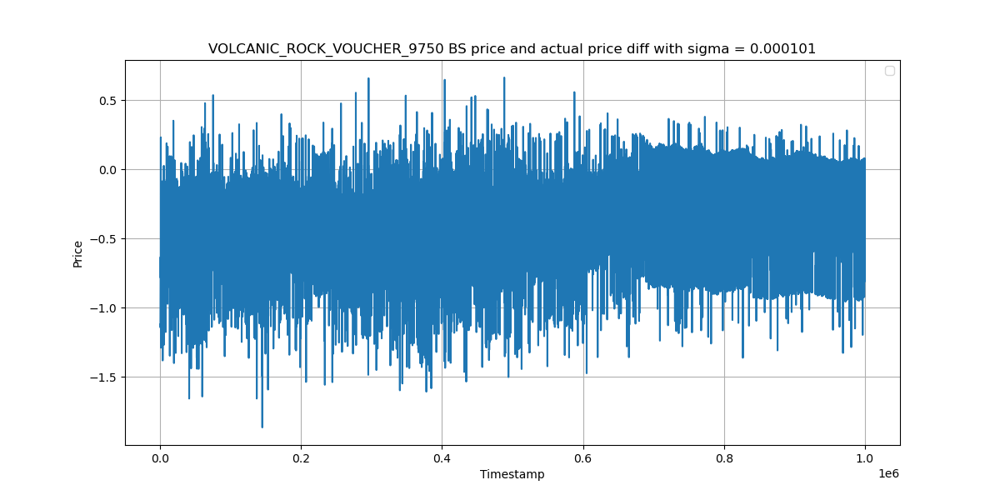

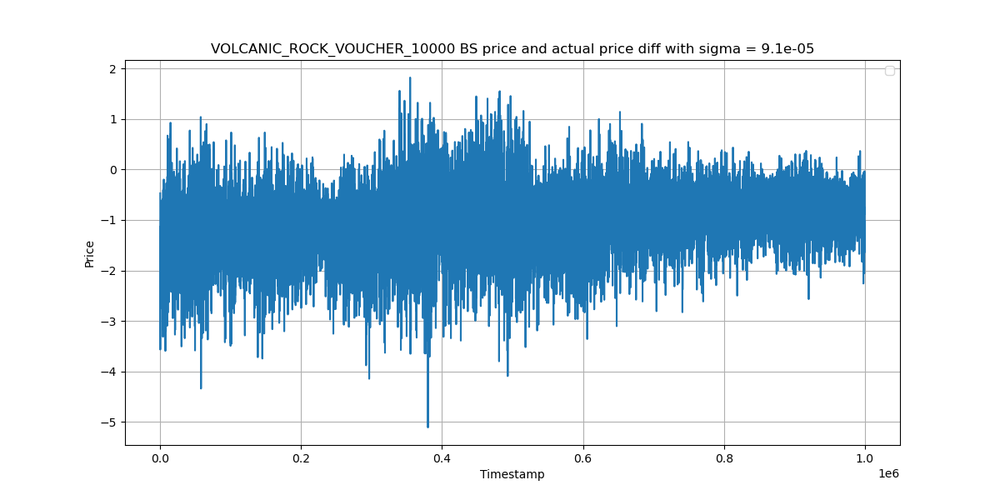

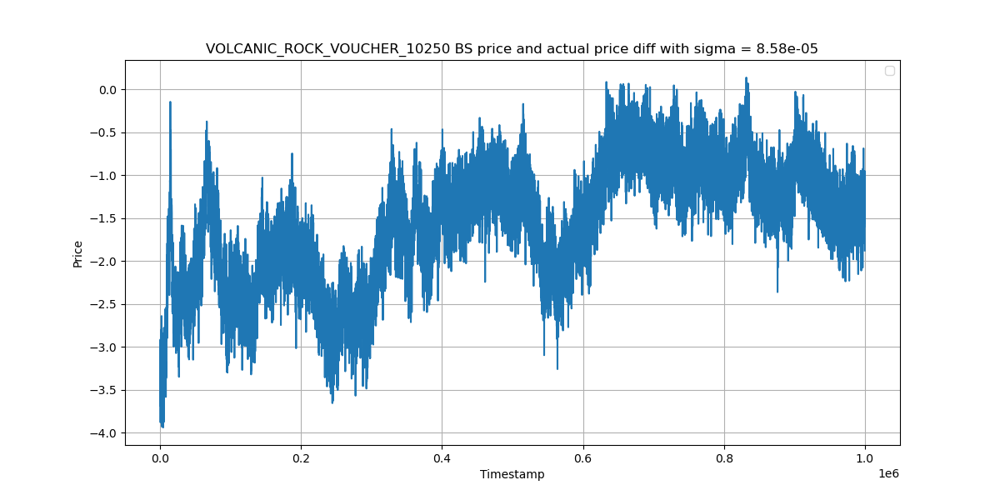

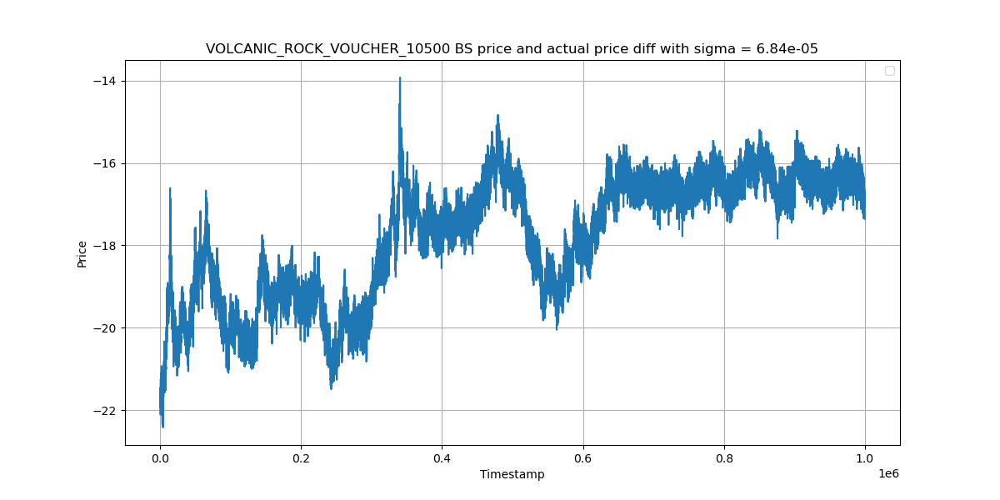

In [79]:
rock_mprice = mid_weight['VOLCANIC_ROCK']

for prod in products[1:]:

    c_price_diff = [c_prices[prod][i] - mid_weight[prod][i] for i in range(len(c_prices[prod]))]
    rock_c_price_diff = [rock_mprice[i] - c_prices[prod][i] for i in range(len(c_prices[prod]))]

    plt.figure(figsize=(12, 6))
    plt.plot(df_rock['timestamp'],c_price_diff)
    plt.xlabel('Timestamp')
    plt.ylabel('Price')
    plt.title(f"{prod} BS price and actual price diff with sigma = {sigma[prod]}")
    plt.legend()
    plt.grid(True)
    plt.show()

C:\Users\amino\AppData\Local\Temp\ipykernel_27212\150193830.py:13: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


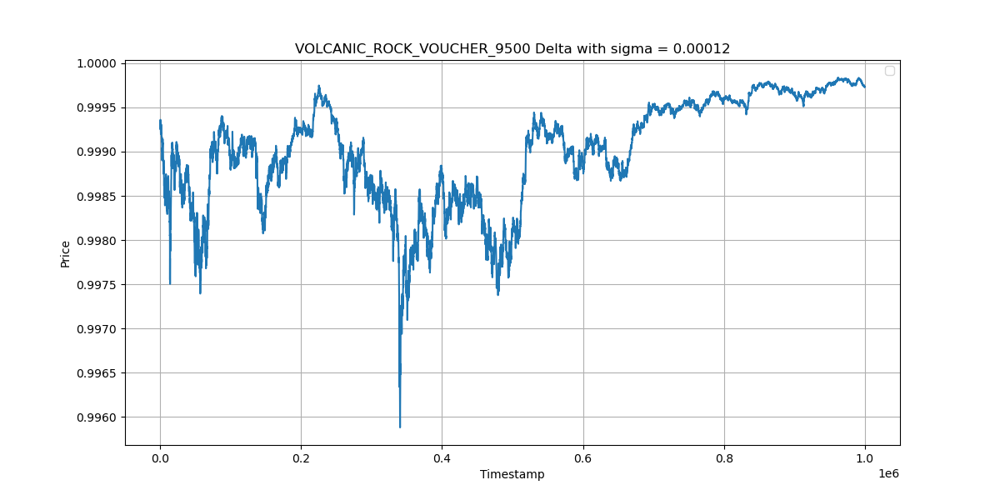

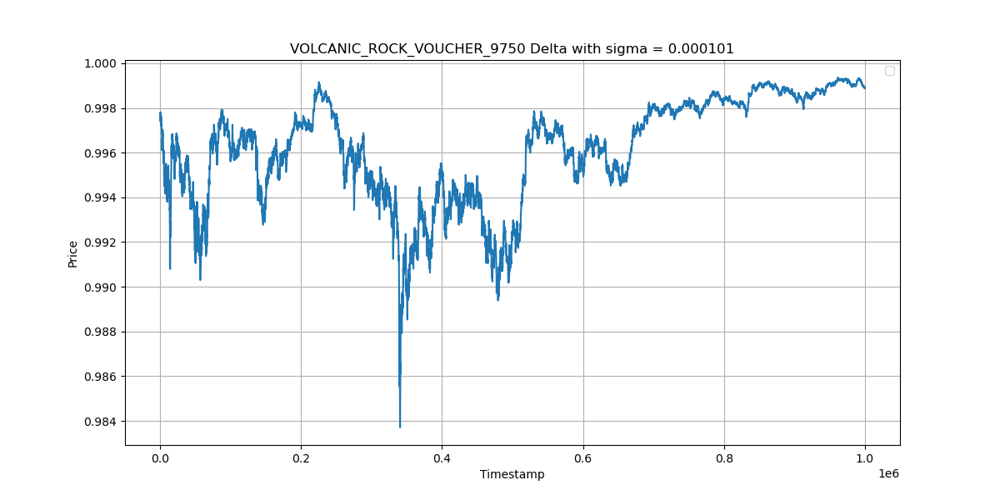

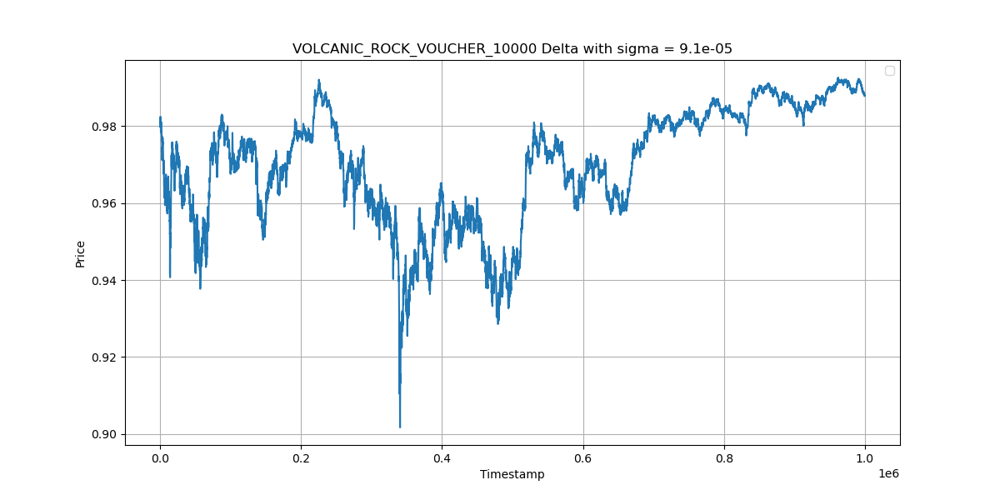

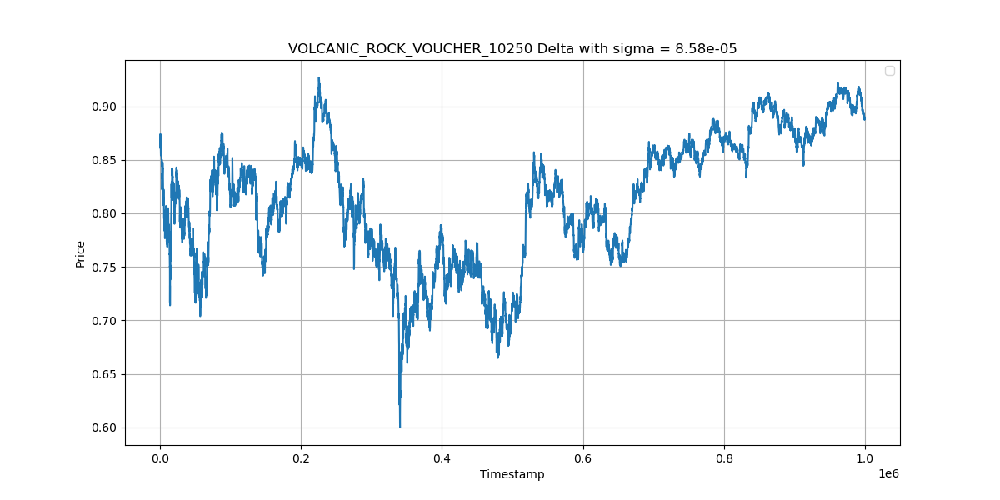

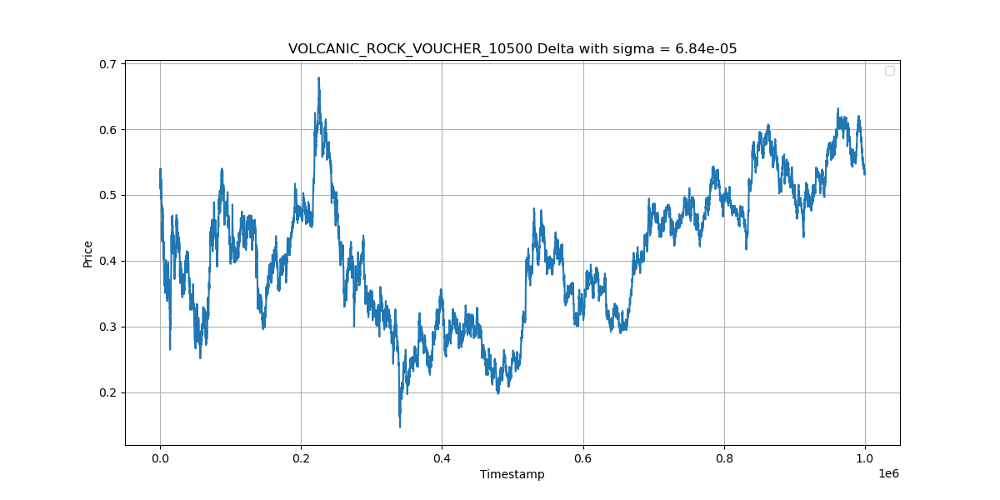

In [83]:
rock_mprice = mid_weight['VOLCANIC_ROCK']

for prod in products[1:]:

    c_price_delta_diff = [c_prices_delta[prod][i] - mid_weight[prod][i] for i in range(len(c_prices[prod]))]
    rock_c_price_diff = [rock_mprice[i] - c_prices[prod][i] for i in range(len(c_prices[prod]))]

    plt.figure(figsize=(12, 6))
    plt.plot(df_rock['timestamp'],delta_lst[prod])
    plt.xlabel('Timestamp')
    plt.ylabel('Price')
    plt.title(f"{prod} Delta with sigma = {sigma[prod]}")
    plt.legend()
    plt.grid(True)
    plt.show()

C:\Users\amino\AppData\Local\Temp\ipykernel_27212\2611840246.py:9: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


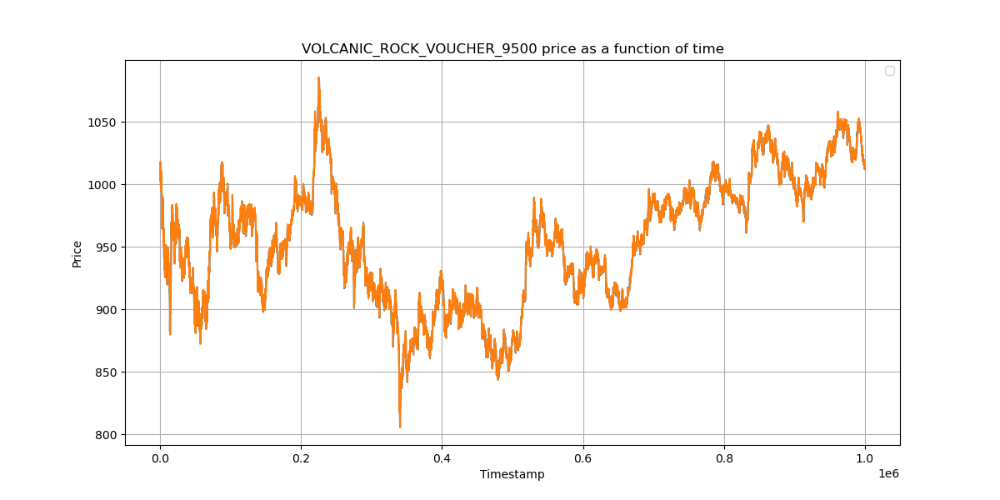

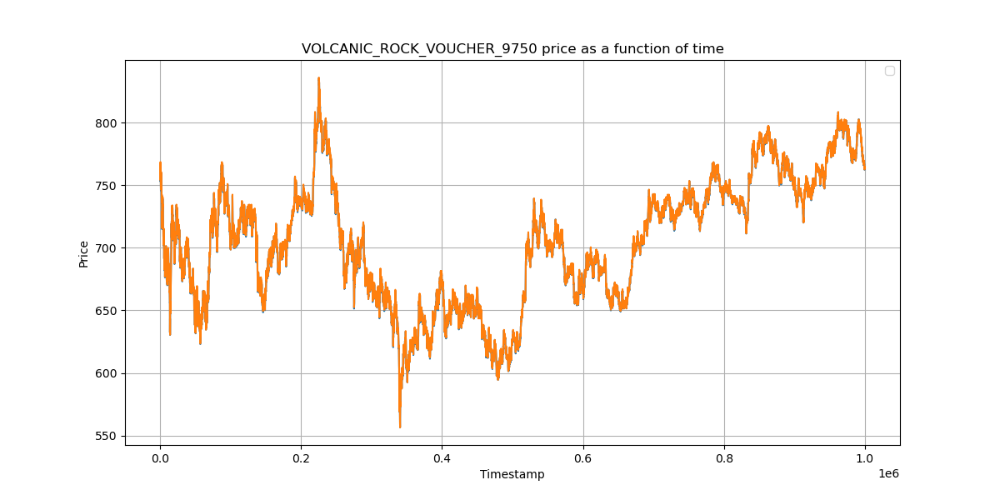

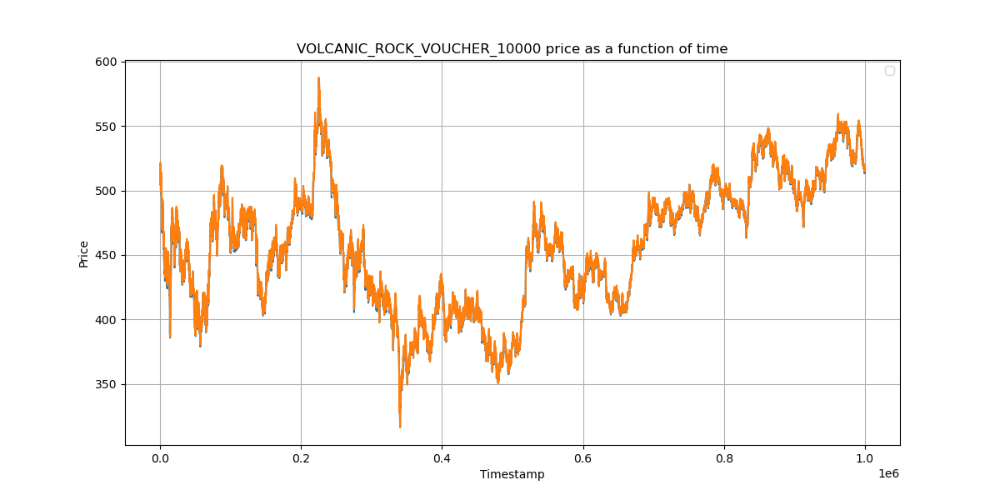

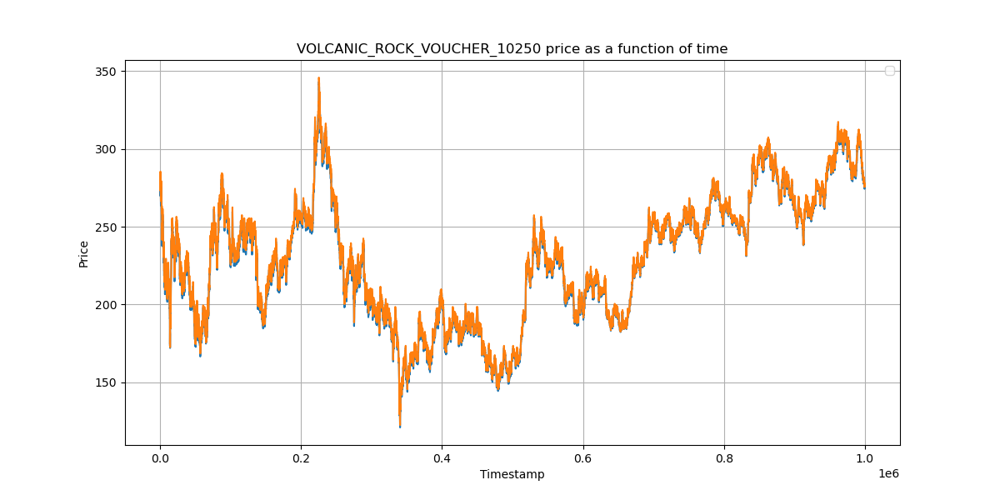

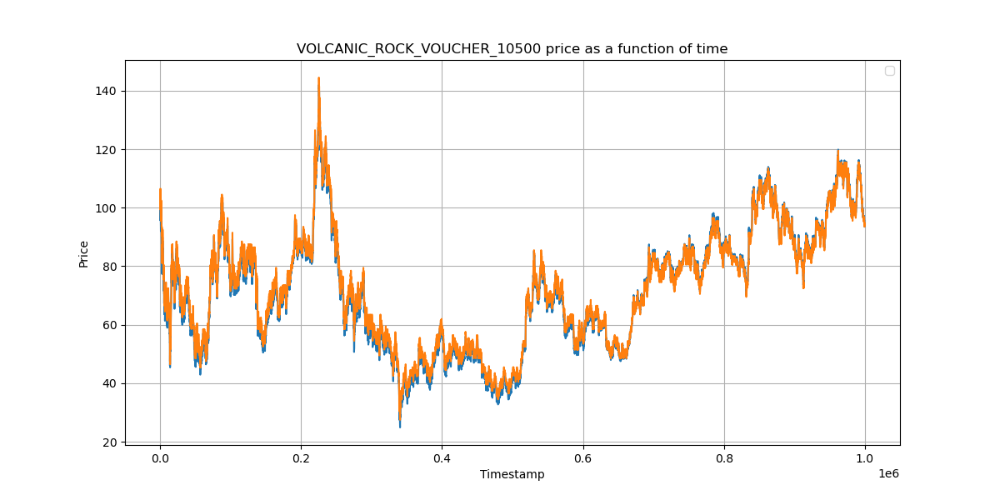

In [72]:
for prod in products[1:]:

    plt.figure(figsize=(12, 6))
    plt.plot(df_rock['timestamp'],c_prices[prod])
    plt.plot(df_rock['timestamp'],mid_weight[prod])
    plt.xlabel('Timestamp')
    plt.ylabel('Price')
    plt.title(prod + ' price as a function of time')
    plt.legend()
    plt.grid(True)
    plt.show()